# Locating lymph node cell types with the integrated immune organ referece

In [1]:
import sys, ast, os
import time
import pickle
import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import os
from plotnine import *
import matplotlib.pyplot as plt 
import matplotlib
data_type = 'float32'
os.environ["THEANO_FLAGS"] = 'device=cuda,floatX=' + data_type + ',force_device=True'
# /nfs/team283/vk7/software/miniconda3farm5/envs/cellpymc/bin/pip install git+https://github.com/vitkl/cell2location.git
sys.path.insert(1, '/nfs/team205/vk7/sanger_projects/BayraktarLab/cell2location/')
sys.path.insert(1, '/nfs/team205/vk7/sanger_projects/cell2location_dev/')

import cell2location

from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
import seaborn as sns
import glob
from re import sub

# scanpy prints a lot of warnings
import warnings
warnings.filterwarnings('ignore')

WARNING (theano.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
/nfs/users/nfs_v/vk7/.local/lib/python3.7/site-packages/theano/gpuarray/dnn.py:184: UserWarning: Your cuDNN version is more recent than Theano. If you encounter problems, try updating Theano or downgrading cuDNN to a version >= v5 and <= v7.
Using cuDNN version 7605 on context None
Mapped name None to device cuda: Tesla V100-SXM2-32GB (0000:62:00.0)


`THEANO_FLAGS='force_device=True'` forces the package to use GPU. Pay attention to error messages that might indicate theano failed to initalise the GPU.   
Do not forget to change `device=cuda4` to your available GPU id. Use `device=cuda` / `device=cuda0` if you have just one locally or if you are requesting one GPU via HPC cluster job.

### Outline

1. Loading Visium data and single cell reference
2. Show UMAP of cells and locations
3. cell2location analysis in one step
4. Automatic discrete region identification by clustering cell densities
5. Visualize cell type density gradients using diffusion maps

## 1. Loading Visium data and single cell reference

First let's read spatial Visium data from 10X Space Ranger output. Here we load sample annotations.

In [2]:
sc_data_folder = '/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/data/b_t_cells_tonsils_hk/'
results_folder = '/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/selected_results/lymph_nodes_analysis/'

Next we load the mRNA count for each Visium slide and corresponding histology images as a list `slides` and as a single anndata object `adata`. We need this redundancy because scanpy plotting over the histology image does not work with multiple sections.   

In [3]:
help(sc.datasets.visium_sge)

Help on function visium_sge in module scanpy.datasets._datasets:

visium_sge(sample_id: typing_extensions.Literal['V1_Breast_Cancer_Block_A_Section_1', 'V1_Breast_Cancer_Block_A_Section_2', 'V1_Human_Heart', 'V1_Human_Lymph_Node', 'V1_Mouse_Kidney', 'V1_Adult_Mouse_Brain', 'V1_Mouse_Brain_Sagittal_Posterior', 'V1_Mouse_Brain_Sagittal_Posterior_Section_2', 'V1_Mouse_Brain_Sagittal_Anterior', 'V1_Mouse_Brain_Sagittal_Anterior_Section_2'] = 'V1_Breast_Cancer_Block_A_Section_1') -> anndata._core.anndata.AnnData
    Processed Visium Spatial Gene Expression data from 10x Genomics.
    Database: https://support.10xgenomics.com/spatial-gene-expression/datasets
    
    Parameters
    ----------
    sample_id
        The ID of the data sample in 10x’s spatial database.
    
    Returns
    -------
    Annotated data matrix.



In [4]:
adata = sc.datasets.visium_sge('V1_Human_Lymph_Node')
sc.pp.calculate_qc_metrics(adata, inplace=True)

slides = {'LN': adata}

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Now let's look at QC: total number of counts and total number of genes per spot

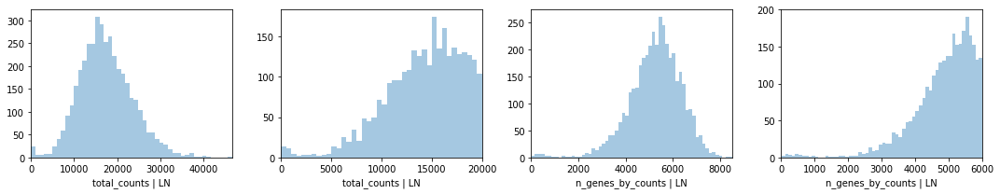

In [5]:
# PLOT QC FOR EACH SAMPLE 
if len(slides) > 2:
    figsize = 4*len(slides)-4
else:
    figsize = 4*len(slides)-1
    
fig, axs = plt.subplots(len(slides), 4, figsize=(15, figsize))
axs = axs.reshape((len(slides), 4))
for i in range(len(slides)):
    #fig.suptitle('Covariates for filtering')
    
    sns.distplot(list(slides.values())[i].obs['total_counts'], 
                 kde=False, ax = axs[i, 0])
    axs[i, 0].set_xlim(0, adata.obs['total_counts'].max())
    axs[i, 0].set_xlabel('total_counts | ' + list(slides.keys())[i])
    
    sns.distplot(list(slides.values())[i].obs['total_counts']\
                 [list(slides.values())[i].obs['total_counts']<20000],
                 kde=False, bins=40, ax = axs[i, 1])
    axs[i, 1].set_xlim(0, 20000)
    axs[i, 1].set_xlabel('total_counts | ' + list(slides.keys())[i])
    
    sns.distplot(list(slides.values())[i].obs['n_genes_by_counts'],
                 kde=False, bins=60, ax = axs[i, 2])
    axs[i, 2].set_xlim(0, adata.obs['n_genes_by_counts'].max())
    axs[i, 2].set_xlabel('n_genes_by_counts | ' + list(slides.keys())[i])
    
    sns.distplot(list(slides.values())[i].obs['n_genes_by_counts']\
                 [list(slides.values())[i].obs['n_genes_by_counts']<6000],
                 kde=False, bins=60, ax = axs[i, 3])
    axs[i, 3].set_xlim(0, 6000)
    axs[i, 3].set_xlabel('n_genes_by_counts | ' + list(slides.keys())[i])
    
plt.tight_layout()

... storing 'feature_types' as categorical
... storing 'genome' as categorical


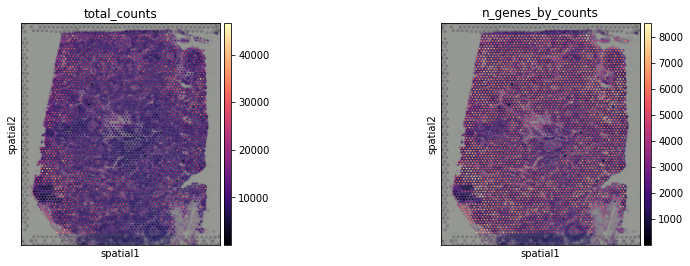

In [6]:
sc.pl.spatial(slides['LN'], img_key = "hires", cmap='magma',
              color=['total_counts', 'n_genes_by_counts'],
              gene_symbols='SYMBOL', size=0.8)

In [7]:
sc.logging.print_versions()

-----
anndata     0.7.4
scanpy      1.6.0
sinfo       0.3.1
-----
PIL                 8.0.0
anndata             0.7.4
arviz               0.10.0
backcall            0.2.0
cairo               1.19.1
cell2location       NA
cffi                1.14.3
cftime              1.2.1
cloudpickle         1.6.0
colorama            0.4.3
cutils_ext          NA
cycler              0.10.0
cython_runtime      NA
dask                2.28.0
dateutil            2.8.1
decorator           4.4.2
descartes           NA
fastprogress        0.2.7
get_version         2.1
h5py                2.10.0
igraph              0.8.2
importlib_metadata  1.7.0
ipykernel           5.3.4
ipython_genutils    0.2.0
ipywidgets          7.5.1
jedi                0.17.2
joblib              0.16.0
kiwisolver          1.2.0
lazylinker_ext      NA
legacy_api_wrap     0.0.0
leidenalg           0.8.2
llvmlite            0.34.0
louvain             0.6.1
mako                1.1.3
markupsafe          1.1.1
matplotlib          3.3.2
mizani

Here we show how to use scanpy to plot results over histology section using anndata object from one section, and 

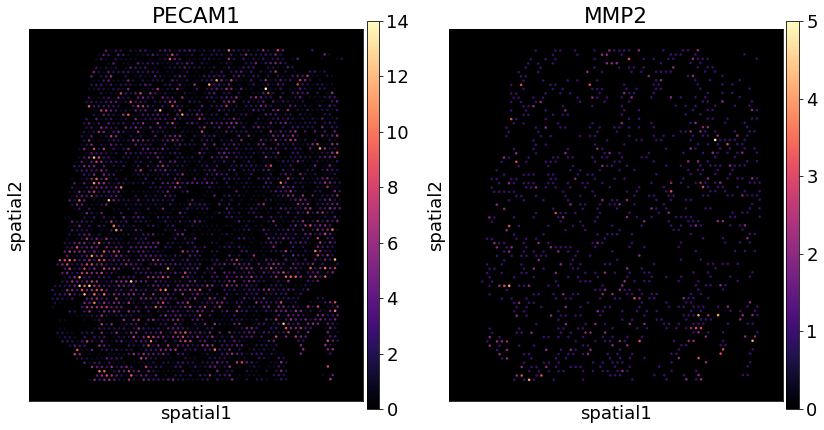

In [8]:
rcParams["axes.facecolor"] = "black"
rcParams["figure.figsize"] = [6,7]
rcParams["font.size"] = 18

sc.pl.spatial(adata, 
              color=["PECAM1", "MMP2"], img_key='hires', alpha_img=0,
              vmin=0, cmap='magma', #vmax=3.8,
              gene_symbols='SYMBOL', size=0.8
             )

In [9]:
adata_vis = adata.copy()
adata_vis.raw = adata_vis
adata_vis.obs['sample'] = list(adata_vis.uns['spatial'].keys())[0]

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


### Load cell type expression signatures programmes <a class="anchor" id="Loading_signatures"></a>

In [10]:
reg_mod_name = 'RegressionNBV4Torch_57covariates_73260cells_10237genes'
reg_path = f'{results_folder}regression_model/{reg_mod_name}/'

adata_snrna_raw = sc.read(f'{reg_path}sc.h5ad')
#r = pickle.load(file = open(f'{reg_path}model_.p', "rb"))
#reg_mod = r['mod']

In [11]:
# export inferred averages in each cluster
inf_aver = adata_snrna_raw.var.copy()
inf_aver = inf_aver.loc[:, ['mean_cov_effect_Subset_'  in i for i in inf_aver.columns]]
from re import sub
inf_aver.columns = [sub('mean_cov_effect_Subset_', '', i) for i in inf_aver.columns]

# scale up by average sample scaling factor
inf_aver = inf_aver * adata_snrna_raw.uns['regression_mod']['post_sample_means']['sample_scaling'].mean()

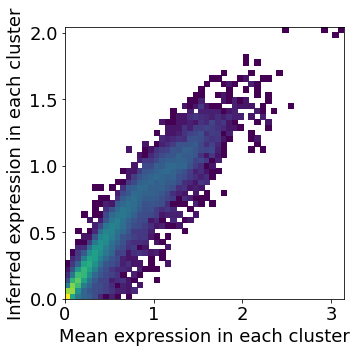

In [12]:
# compute mean expression of each gene in each cluster
aver = cell2location.cluster_averages.cluster_averages.get_cluster_averages(adata_snrna_raw, 'Subset')
aver = aver.loc[adata_snrna_raw.var_names,:]

rcParams["axes.facecolor"] = "white"
with matplotlib.rc_context({"figure.figsize": (5,5)}):
    plt.hist2d(np.log10(aver.values.flatten()+1), np.log10(inf_aver.values.flatten()+1),
               bins=50, norm=matplotlib.colors.LogNorm());
    plt.xlabel('Mean expression in each cluster');
    plt.ylabel('Inferred expression in each cluster');

# 3. cell2location analysis in one step

Here we perform the first step in one function run - train cell2location model to learn cell locations. Results are shown below and saved to:  

In [13]:
results_folder

'/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/selected_results/lymph_nodes_analysis/'

In [14]:
from pycell2location.models.LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlpha import LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlpha

In [15]:
sc.settings.set_figure_params(dpi = 100, color_map = 'viridis', dpi_save = 100,
                              vector_friendly = True, format = 'pdf',
                              facecolor='white')

y_s_prior = [200]

for y_i in y_s_prior:
    r = cell2location.run_cell2location(
                          sc_data=inf_aver, 
                          sp_data=adata_vis,

                          model_name=LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlpha,

                          verbose=True, return_all=True,

                          summ_sc_data_args={'cluster_col': "Subset"},

                          train_args={'n_iter': 30000, 'learning_rate': 0.005,
                                      'sample_name_col': 'sample'},

                          posterior_args={'n_samples': 1000},

                          export_args={'path': results_folder, 
                                       'run_name_suffix': f'_input_averages_batch1024_l2_0001_n_comb50_5_cps5_fpc3_y_s{y_i}_gl1',
                                       'save_model': False,
                                       'scanpy_coords_name': 'spatial', 'export_q05': True},

                          model_kwargs={ # Prior on the number of cells, cell types and co-located combinations

                        'cell_number_prior': {
                            # Use visual inspection of the tissue image to determine 
                            # the average number of cells per spot,
                            # an approximate count is good enough:
                            'cells_per_spot': 30, 
                            # Prior on the number of cell types (or factors) in each spot
                            'factors_per_spot': 15, 
                            # Prior on the number of correlated cell type combinations in each spot
                            'combs_per_spot': 5
                        },

                        'detection_alpha_hyp_prior':{'mean': y_i, 'sd': 1},
                        'detection_mean_hyp_prior':{'alpha': 1, 'beta': 1},

                         # Prior on change in sensitivity between technologies
                        'gene_level_prior':{'mean': 1, 'alpha_mean': 3, 'alpha_sd': 1},
          }
    )

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


### Summarising single cell clusters ###
### Creating model ### - time 0.02 min
### Analysis name: LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlpha_1experiments_34clusters_4039locations_10241genes_input_averages_batch1024_l2_0001_n_comb50_5_cps5_fpc3_y_s200_gl1
### Training model ###


Finished [100%]: Average Loss = 4.2032e+07


Finished [100%]: Average Loss = 4.2035e+07



### Sampling posterior ### - time 46.89 min



### Saving results ###


... storing 'sample' as categorical


### Ploting results ###
### Plotting posterior of W / cell locations ###
### Done ### - time 51.25 min


Trained model object can be pulled from `r['mod']`, cell locations are added to `r['sp_data']` as columns of `sp_data.obs` and all paramters of the model are exported to `sp_data.uns['mod']`. This anndata object and a csv file `W.csv` / `W_q05.csv` with cell locations are always saved to the results directory. 

When `'save_model': True`, the trained model `r['mod']` is also saved as a pickle file. You can load the model later and continue training. 

#### Evaluating training

Now we need to check if our model has trained successfully by looking at the loss / cost function over training iterations. This plot omits the first 20% of training iterations during which loss changes by orders of magnitude.

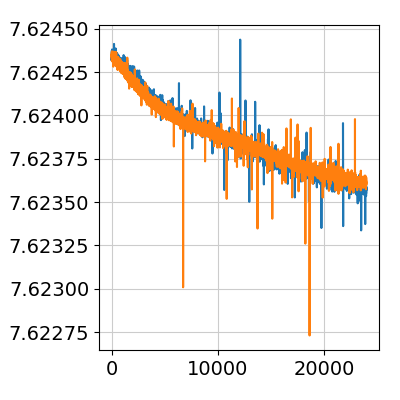

In [16]:
r = {'run_name': 'LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlpha_1experiments_34clusters_4039locations_10241genes_input_averages_batch1024_l2_0001_n_comb50_5_cps5_fpc3_y_s200_gl1'}

from IPython.display import Image
Image(filename=results_folder +r['run_name']+'/plots/training_history_without_first_20perc.png',
      width=400)

We also need to evaluate the reconstruction accuracy or how well cell types and uniform background explain spatial data bu comparing expected value of the model (NB mean) to observed count of each gene across locations. The ideal case is perfect diagonal plot.

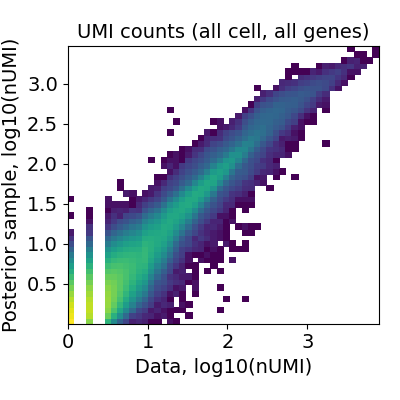

In [17]:
Image(filename=results_folder +r['run_name']+'/plots/data_vs_posterior_mean.png',
      width=400)

Finally, we need to evaluate robustness of the identified locations by comparing consistency of inferred locations between two independent training restarts.

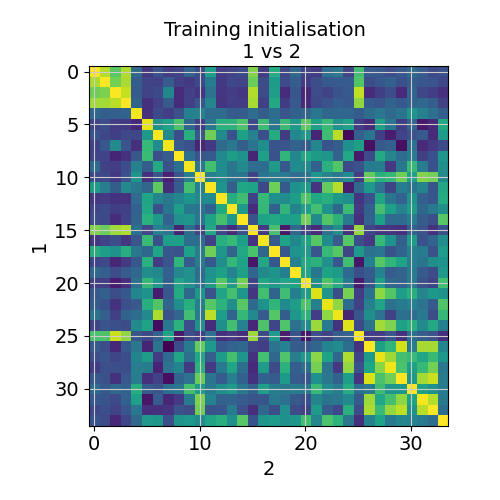

In [18]:
Image(filename=results_folder +r['run_name']+'/plots/evaluate_stability.png',
      width=400)

#### Loading saved results

We can load our model and associated object after training (this also needs a GPU to be available and we need to know the analysis name):

pickle_model = results_folder + 'std_model/LocationModelV7_V4_V4_32clusters_4039locations_21117genes/model_.p'
r = pickle.load(open(pickle_model, "rb"))

adata_vis = r['sp_data']

Alternatively we can load the results of the model saved into `sp_data`:

In [19]:
sp_data_file = results_folder +r['run_name']+'/sp.h5ad'
adata_vis = anndata.read(sp_data_file)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [20]:
# rate prior for overdispersion parameter: >2 low overdispersion
adata_vis.uns['mod']['post_sample_means']['phi_hyp']

array([[5.362752]], dtype=float32)

#### Advanced plotting of cell locations

Alternatively we can visualise locations of multiple cell types at once using a plotting tool from cell2location package.

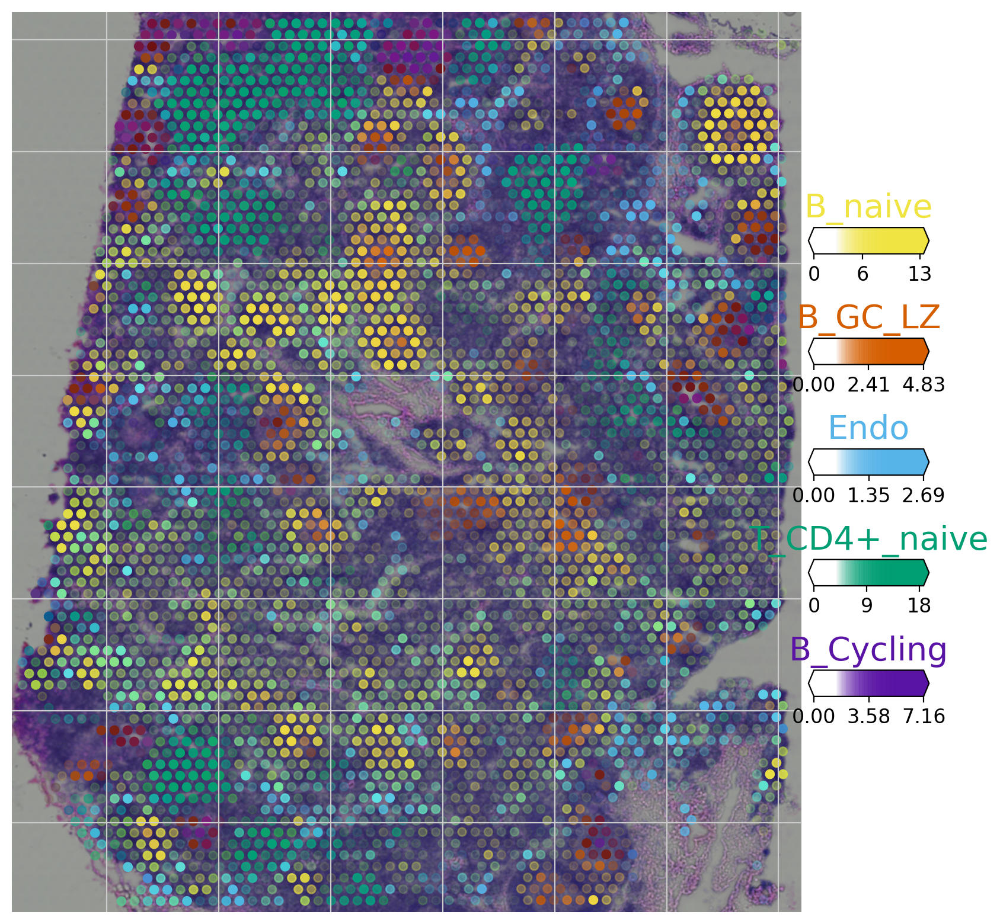

In [21]:
from cell2location.plt.mapping_video import plot_spatial

# select up to 6 clusters 
sel_clust = ['B_naive', 'B_GC_LZ', 'Endo', 'T_CD4+_naive', 'B_Cycling']
sel_clust_col = ['q05_spot_factors' + str(i) for i in sel_clust]
#sel_clust_col = ['q05_nUMI_factors' + str(i) for i in sel_clust]
s = 'LN'

crop_x = [230, 1640]
crop_y = [1760, 150]

with matplotlib.rc_context({'figure.figsize': (10, 10)}):
    fig = plot_spatial(adata_vis.obs[sel_clust_col], labels=sel_clust,
                  coords=adata_vis.obsm['spatial'] \
                          * list(adata_vis.uns['spatial'].values())[0]['scalefactors']['tissue_hires_scalef'], 
                  show_img=True, img_alpha=1, 
                  style='fast', # fast or dark_background,
                  crop_x=crop_x, crop_y=[crop_y[1], crop_y[0]],
                  img=list(adata_vis.uns['spatial'].values())[0]['images']['hires'],
                  circle_diameter=5, colorbar_position='right')

Here we use standard scanpy pipeline to plot cell locations over histology images:

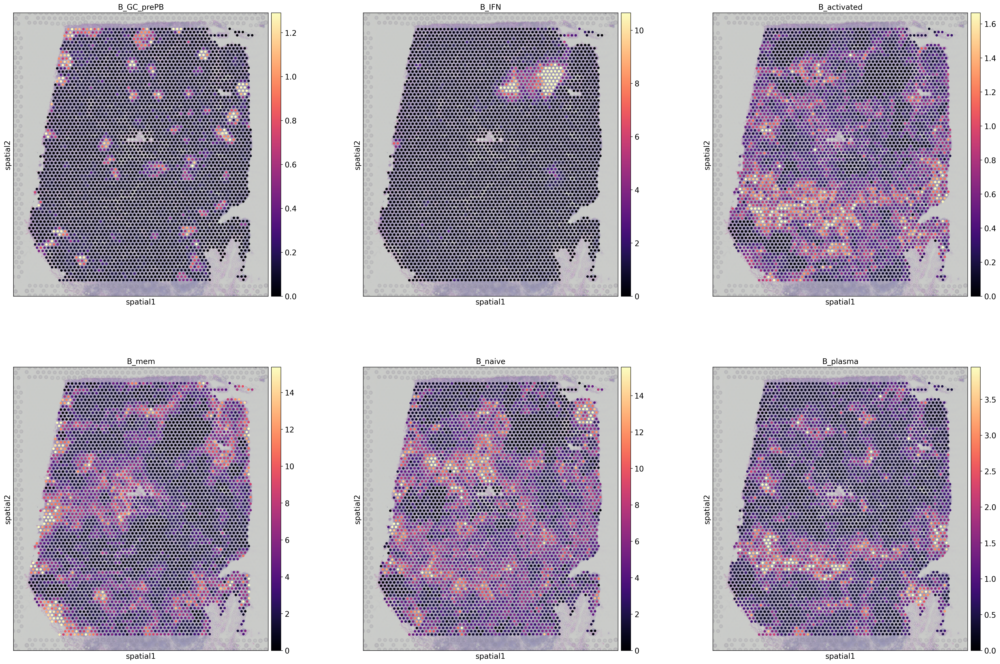

In [22]:
rcParams["axes.facecolor"] = "white"
rcParams["figure.figsize"] = [10,10]
rcParams["font.size"] = 18

s = 'LN'
sel_clust_col = ['q05_spot_factors' in i for i in adata_vis.obs.columns]
sel_clust_col = adata_vis.obs.columns[sel_clust_col]
from re import sub # create nice names
sel_clust = [sub('q05_spot_factors', '', i) for i in sel_clust_col]

# log-transform and save with nice names
adata_vis.obs[sel_clust] = (adata_vis.obs[sel_clust_col])

sc.pl.spatial(adata_vis, cmap='magma',
              color=sel_clust[3:9], # limit size in this notebook
              ncols=3, 
              size=1, img_key='hires', 
              alpha_img=0.5,
              vmin=0, vmax='p99.0'
             )

## 4. Automatic discrete region identification by clustering cell densities
We find regions by clustering spots based on inferred molecule contributions of each cell type. We use standard leiden clustering. Results are saved in `adata_vis.obs['leiden']`.

In [23]:
sample_type = 'q05_spot_factors'
col_ind = [sample_type in i for i in adata_vis.obs.columns.tolist()]
adata_vis.obsm[sample_type] = adata_vis.obs.loc[:,col_ind].values

# compute KNN using the cell2location output
sc.pp.neighbors(adata_vis, use_rep=sample_type,
                n_neighbors = 20)

# Cluster spots into regions using scanpy
sc.tl.leiden(adata_vis, resolution=1)

In [24]:
adata_vis.obs["region_cluster"] = adata_vis.obs["leiden"]
adata_vis.obs["region_cluster"] = adata_vis.obs["region_cluster"].astype("category")

Since the clustering is done jointly, the cluster identities match between sections.

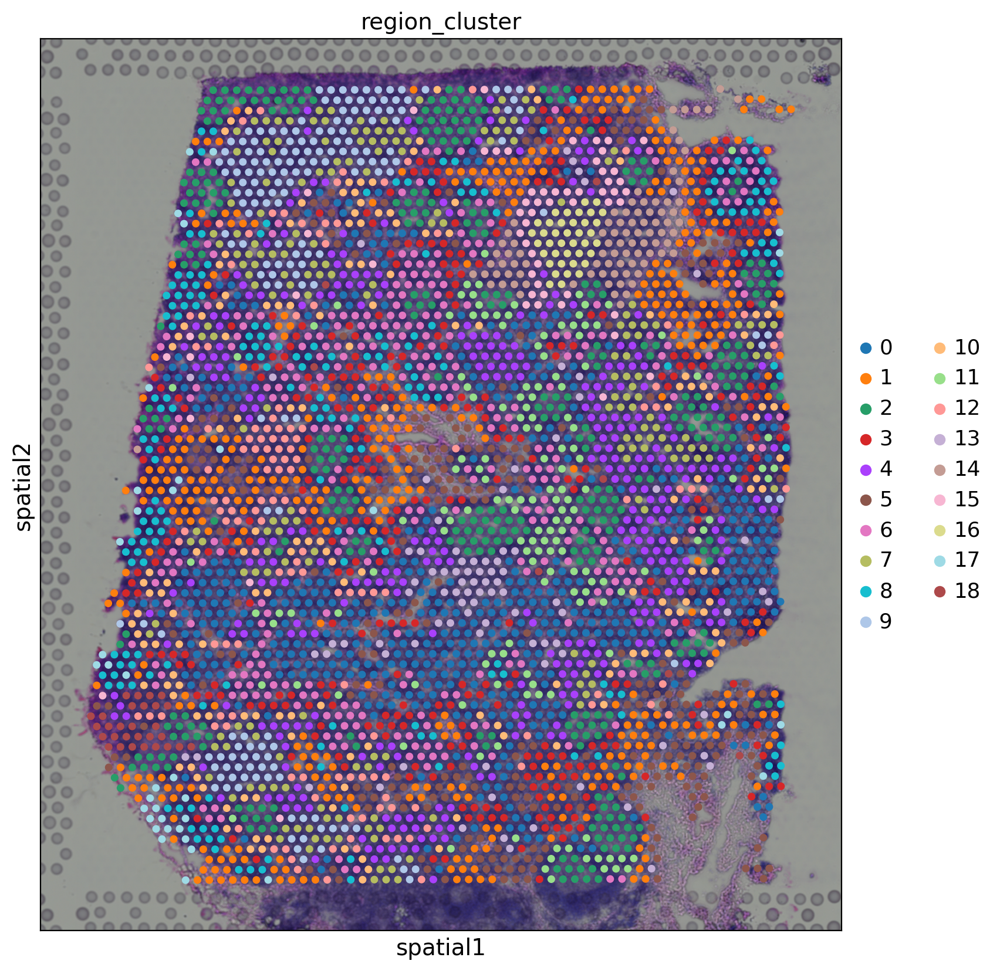

In [25]:
rcParams["figure.figsize"] = [10, 10]
sc.pl.spatial(adata_vis, 
              color=["region_cluster"], img_key='hires', size=1
            );

Consider running `set_figure_params(dpi_save=...)`, which will adjust `matplotlib.rcParams['savefig.dpi']`


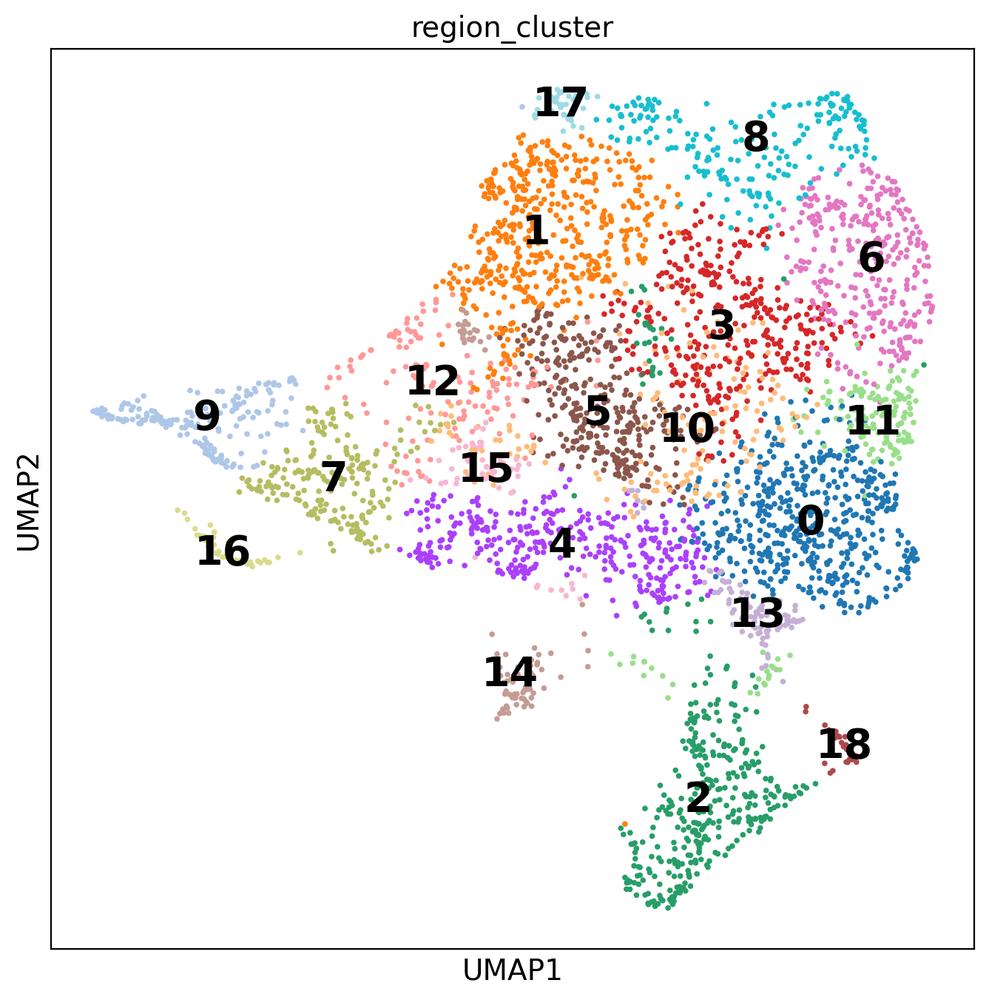

In [26]:
sc.tl.umap(adata_vis, min_dist = 0.3, spread = 1)

sc.settings.figdir = f"{results_folder}{r['run_name']}/"

rcParams['figure.figsize'] = 8, 8
rcParams["axes.facecolor"] = "white"
sc.pl.umap(adata_vis, color=['region_cluster'], size=30,
           color_map=matplotlib.cm.get_cmap('Spectral'),
           ncols = 2, legend_loc='on data',
           legend_fontsize=20, save=f'umap_regions.pdf')

### Which cell types does the model consider co-located?

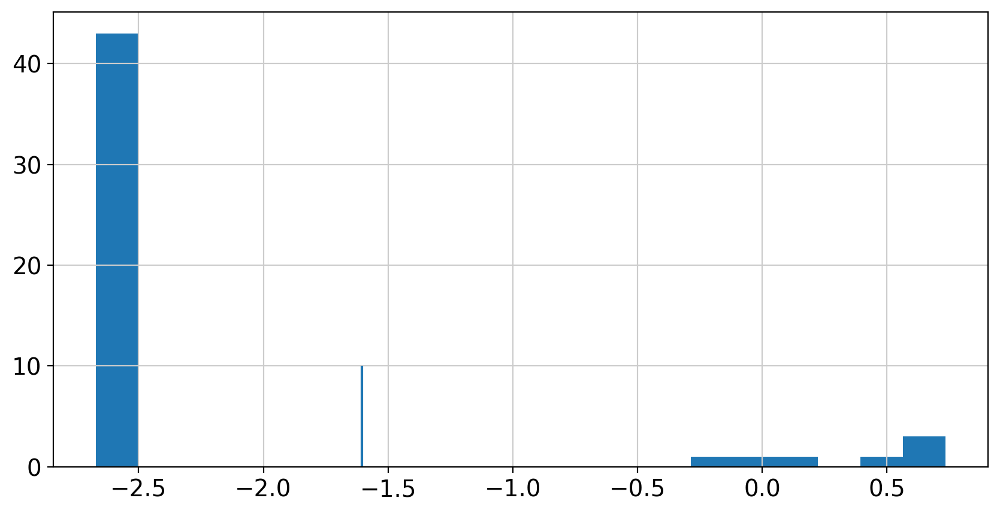

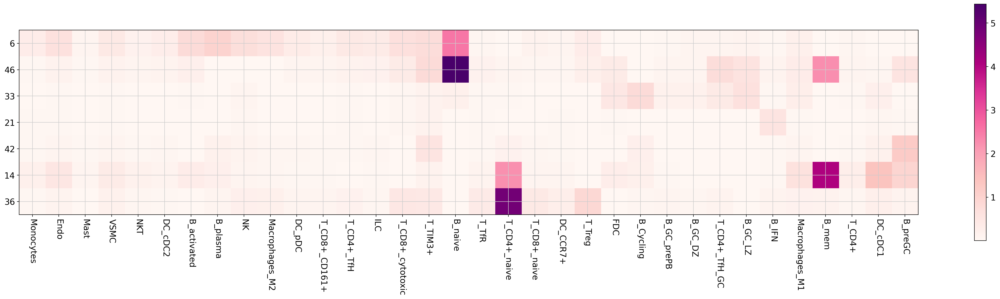

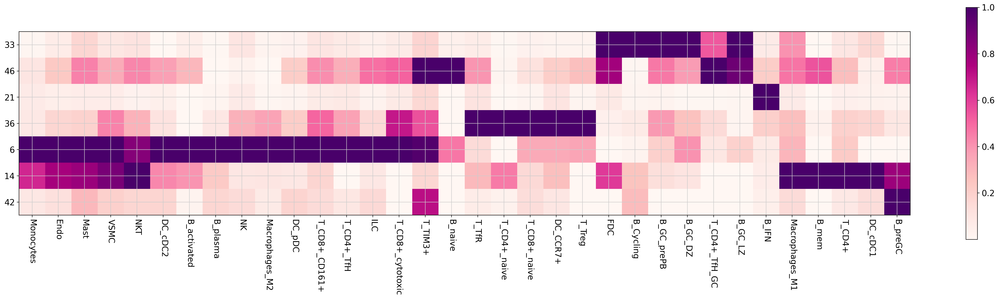

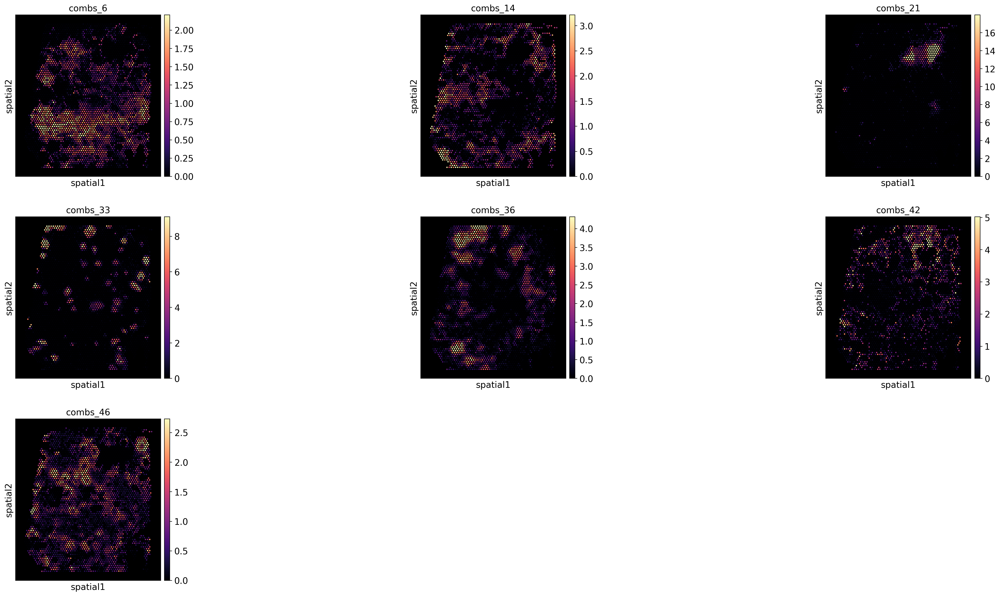

In [27]:
from cell2location.plt.plot_heatmap import clustermap
comb2fact_df = pd.DataFrame(adata_vis.uns['mod']['post_sample_means']['comb2fact'],
                            columns=adata_vis.uns['mod']['fact_names'])

rcParams["figure.figsize"] = [10, 5]
rcParams["axes.facecolor"] = "white"
plt.hist(np.log10(comb2fact_df.max(1)), bins=20);
thresh = 0.0249
plt.vlines(np.log10(thresh), 0, 10);
fact_filt = comb2fact_df.max(1) > thresh

comb2fact_df = comb2fact_df.loc[fact_filt.values, :]

clustermap(comb2fact_df, figure_size=(27, 7))

comb2fact_df_prop = (comb2fact_df / comb2fact_df.max(0))
clustermap(comb2fact_df_prop, figure_size=(27, 7))
plt.savefig(f"{results_folder}{r['run_name']}/w_prior_factors_members.pdf");
    
n_combs = adata_vis.uns['mod']['post_sample_means']['combs_factors'].shape[1]
combs_factors = pd.DataFrame(adata_vis.uns['mod']['post_sample_means']['combs_factors'],
                             columns=[f'combs_{i}' for i in range(n_combs)],
                             index=adata_vis.uns['mod']['obs_names'])
combs_factors = combs_factors.loc[:, fact_filt.values]
adata_vis.obs[combs_factors.columns] = combs_factors

#slide = select_slide(adata_vis, 'ST8059048')
#crop_x, crop_y = get_crop_coord(adata_vis)

#s = 'ST8059048'
#s_name = f'spaceranger100_count_30458_{s}_mm10-3_0_0_premrna'
rcParams["axes.facecolor"] = "black"
sc.pl.spatial(adata_vis, cmap='magma',
              color=combs_factors.columns, # limit size in this notebook
              #library_id=f'{s_name}',
              ncols=3, 
              size=1, img_key='hires', 
              alpha_img=0,
              vmin=0, vmax='p99.0',
              save=f'w_prior_factors{s}.pdf',
             )

In [28]:
adata_vis.uns['mod']['post_sample_q05']['spot_factors'].sum(1).mean(), \
adata_vis.uns['mod']['post_sample_q05']['detection_mean']

(28.018949194270654, array([[0.4041347]]))

[17348.428]

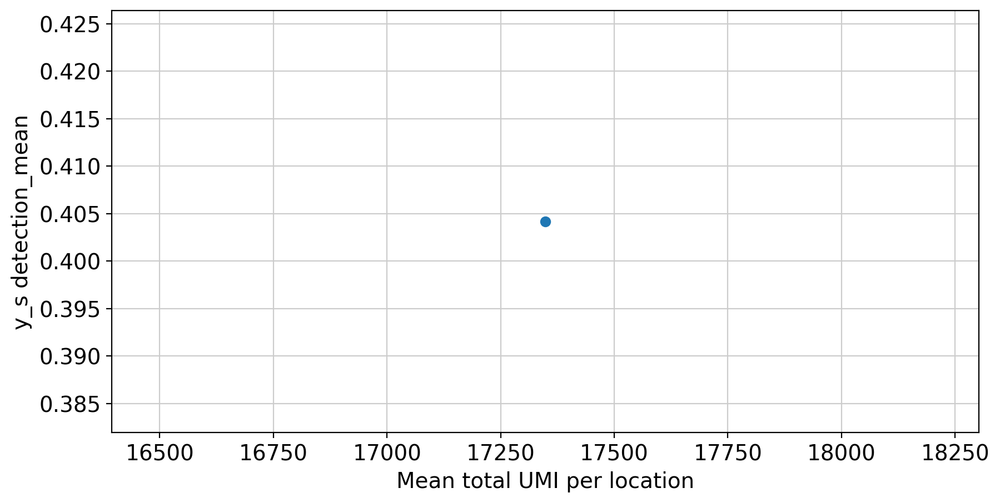

In [29]:
rcParams["figure.figsize"] = [10, 5]
rcParams["axes.facecolor"] = "white"
seq_depth = [adata_vis[adata_vis.obs['sample'] == s,:].X.sum(1).mean() for s in adata_vis.obs['sample'].unique()]
plt.scatter(seq_depth, adata_vis.uns['mod']['post_sample_q05']['detection_mean']);
plt.xlabel('Mean total UMI per location');
plt.ylabel('y_s detection_mean');
plt.savefig(f"{results_folder}{r['run_name']}/mean_total_UMI_vs_y_s.pdf");
seq_depth

In [30]:
gene_level_alpha_inv = adata_vis.uns['mod']['post_sample_q05']['gene_level_alpha_inv']
1 / (gene_level_alpha_inv * gene_level_alpha_inv)

array([[1.58770297]])

In [31]:
adata_vis.uns['mod']['post_sample_q05']['gene_level_mu_hyp']

array([[0.4904253]])

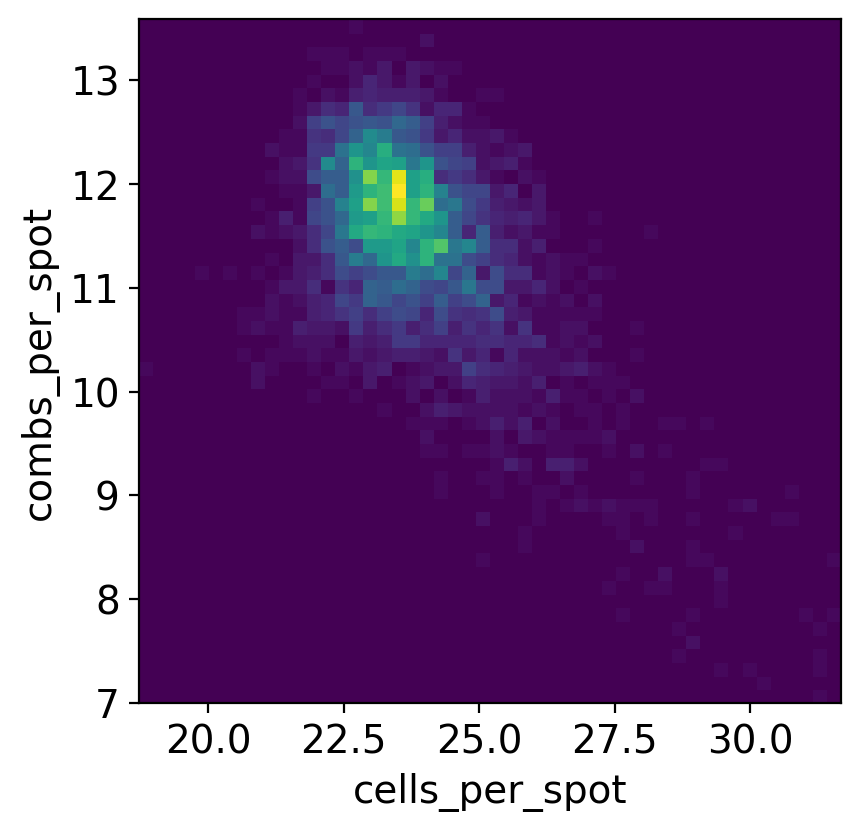

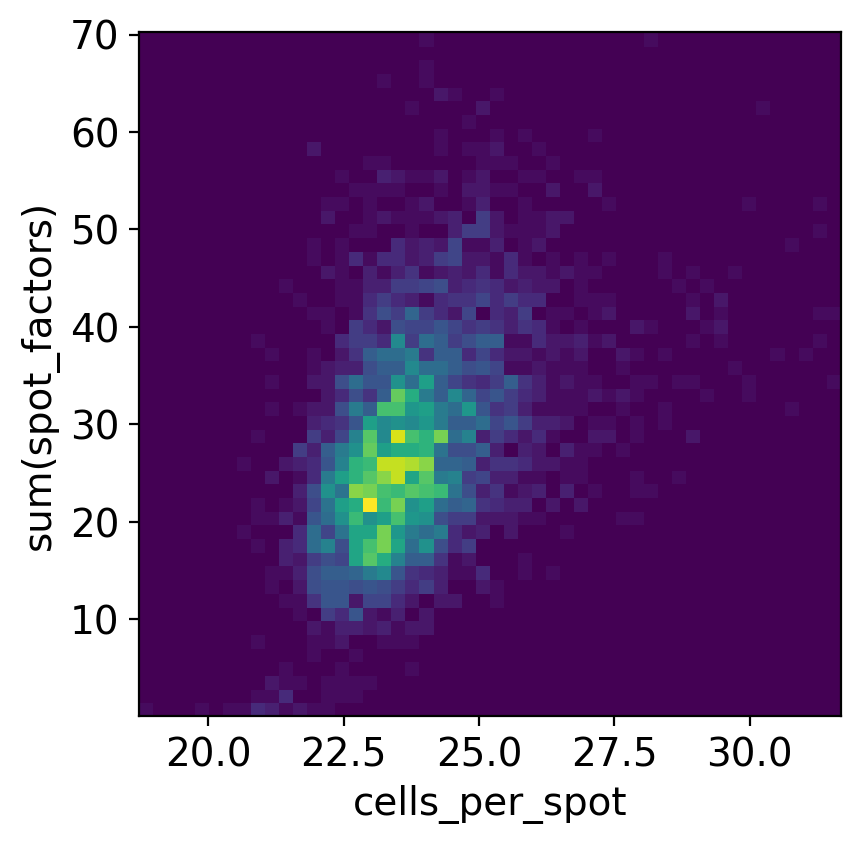

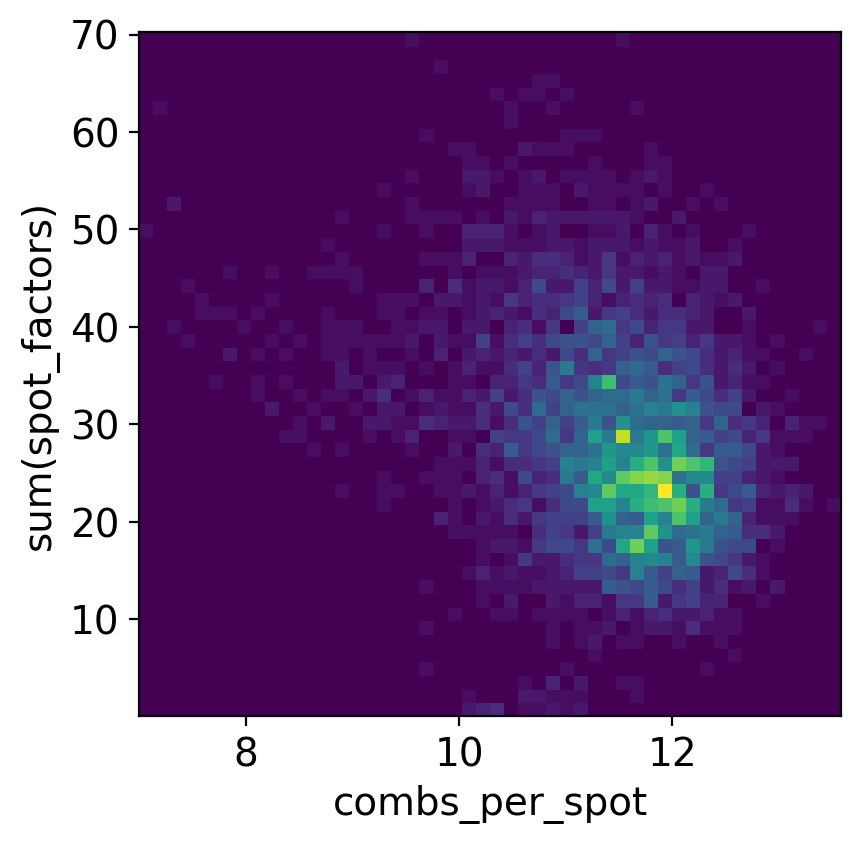

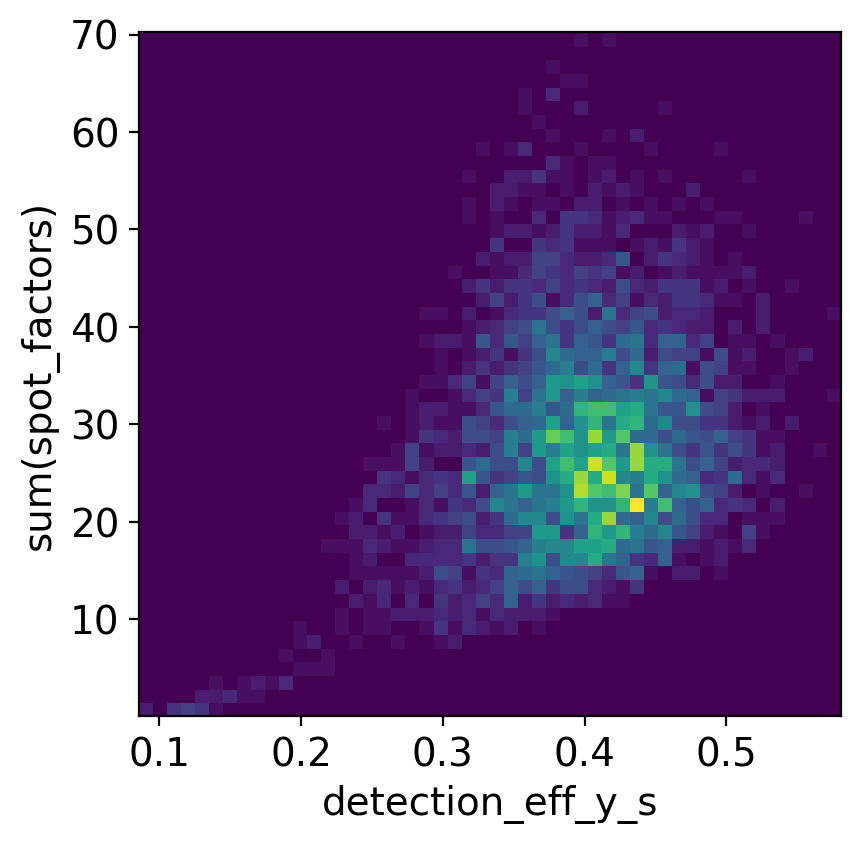

In [32]:
rcParams['figure.figsize'] = 4.5, 4.5
plt.hist2d(adata_vis.uns['mod']['post_sample_q05']['cells_per_spot'].flatten(),
           adata_vis.uns['mod']['post_sample_q05']['combs_per_spot'].flatten(),
           bins=50);
plt.xlabel('cells_per_spot');
plt.ylabel('combs_per_spot');
plt.show()

plt.hist2d(adata_vis.uns['mod']['post_sample_q05']['cells_per_spot'].flatten(),
           adata_vis.uns['mod']['post_sample_q05']['spot_factors'].sum(1).flatten(),
           bins=50);
plt.xlabel('cells_per_spot');
plt.ylabel('sum(spot_factors)');
plt.savefig(f"{results_folder}{r['run_name']}/n_s_vs_w_sf.pdf");
plt.show()

plt.hist2d(adata_vis.uns['mod']['post_sample_q05']['combs_per_spot'].flatten(),
           adata_vis.uns['mod']['post_sample_q05']['spot_factors'].sum(1).flatten(),
           bins=50);
plt.xlabel('combs_per_spot');
plt.ylabel('sum(spot_factors)');
plt.show()

plt.hist2d(adata_vis.uns['mod']['post_sample_q05']['detection_eff_y_s'].flatten(),
           adata_vis.uns['mod']['post_sample_q05']['spot_factors'].sum(1).flatten(),
           bins=50);
plt.xlabel('detection_eff_y_s');
plt.ylabel('sum(spot_factors)');
plt.savefig(f"{results_folder}{r['run_name']}/y_s_vs_w_sf.pdf");
plt.show()

### Export regions for import to 10X Loupe Browser

In [33]:
# add binary labels for each region
region_cluster_bin = adata_vis.obs[['region_cluster']]
# save maps for each sample separately
sam = np.array(adata_vis.obs['sample'])

for i in np.unique(sam):
    
    s1 = region_cluster_bin
    s1 = s1.loc[sam == i]
    s1.index = [x[10:] for x in s1.index]
    s1.index.name = 'Barcode'
    
    s1.to_csv(results_folder +r['run_name']+''\
              +'/region_cluster29_' + i + '.csv')

Save resulting adata with clustering and diffusion maps

In [34]:
adata_file = results_folder \
                +r['run_name']+'/sp_with_clusters.h5ad'
adata_vis.write(adata_file)

Modules and their versions used for this analysis

In [35]:
import sys
for module in sys.modules:
    try:
        print(module,sys.modules[module].__version__)
    except:
        try:
            if  type(modules[module].version) is str:
                print(module,sys.modules[module].version)
            else:
                print(module,sys.modules[module].version())
        except:
            try:
                print(module,sys.modules[module].VERSION)
            except:
                pass

ipykernel 5.3.4
ipykernel._version 5.3.4
json 2.0.9
re 2.2.1
IPython 7.18.1
IPython.core.release 7.18.1
logging 0.5.1.2
zlib 1.0
traitlets 5.0.4
traitlets._version 5.0.4
argparse 1.1
ipython_genutils 0.2.0
ipython_genutils._version 0.2.0
platform 1.0.8
pygments 2.7.1
pexpect 4.8.0
ptyprocess 0.6.0
decorator 4.4.2
pickleshare 0.7.5
backcall 0.2.0
prompt_toolkit 3.0.7
wcwidth 0.2.5
jedi 0.17.2
parso 0.7.1
colorama 0.4.3
ctypes 1.1.0
_ctypes 1.1.0
urllib.request 3.7
jupyter_client 6.1.7
jupyter_client._version 6.1.7
zmq 19.0.2
zmq.backend.cython 40302
zmq.backend.cython.constants 40302
zmq.sugar 19.0.2
zmq.sugar.constants 40302
zmq.sugar.version 19.0.2
jupyter_core 4.6.3
jupyter_core.version 4.6.3
distutils 3.7.8
_curses b'2.2'
dateutil 2.8.1
six 1.15.0
decimal 1.70
_decimal 1.70
scanpy 1.6.0
numpy 1.19.4
numpy.core 1.19.4
numpy.core._multiarray_umath 3.1
numpy.lib 1.19.4
numpy.linalg._umath_linalg b'0.1.5'
scipy 1.5.3
scipy._lib._uarray 0.5.1+49.g4c3f1d7.scipy
anndata 0.7.4
h5py 2.10.0
n